In [ ]:
import os

os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'


import tensorflow as tf
import matplotlib.pyplot as plt
import random
import cv2
import numpy as np

if tf.test.gpu_device_name():
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))
else:
    print("Please install GPU version of TF")


Default GPU Device: /device:GPU:0


In [ ]:
# Load pictures
import cv2
import random
import os
imagesX = []
imagesY = []
size = 256
for file in os.listdir("/content/drive/MyDrive/DLP_Lab8/apples_samples"):
    apple_image = cv2.imread(f"/content/drive/MyDrive/DLP_Lab8/apples_samples/{file}")
    #apple_image = cv2.resize(apple_image, (size,size))
    imagesX.append(apple_image)

for file in os.listdir("/content/drive/MyDrive/DLP_Lab8/oranges_samples"):
  orange_image = cv2.imread(f"/content/drive/MyDrive/DLP_Lab8/oranges_samples/{file}")
  #orange_image = cv2.resize(orange_image, (size,size))
  imagesY.append(orange_image)

imagesX = np.array(imagesX).astype('float32')
imagesY = np.array(imagesY).astype('float32')
imagesX = imagesX / 255.0
imagesY = imagesY / 255.0
print('loaded',len(imagesX),imagesX.shape)
print('loaded',len(imagesY),imagesY.shape)


loaded 1260 (1260, 256, 256, 3)
loaded 1350 (1350, 256, 256, 3)


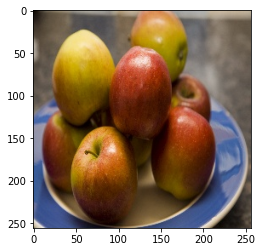

In [ ]:
#convert to rgb
for i in range(len(imagesX)):
  imagesX[i] = cv2.cvtColor(imagesX[i], cv2.COLOR_BGR2RGB)
for i in range(len(imagesY)):
  imagesY[i] = cv2.cvtColor(imagesY[i], cv2.COLOR_BGR2RGB)


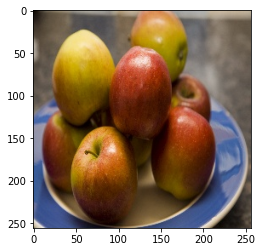

In [ ]:
#show examples
plt.imshow(imagesX[1])

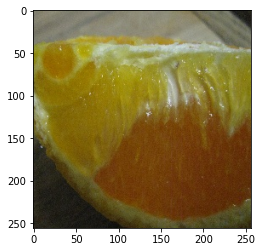

In [ ]:
plt.imshow(imagesY[1])

In [ ]:
# create networks
import pix2pix

channels = 3
generator_g = pix2pix.unet_generator(channels, norm_type='instancenorm')
generator_f = pix2pix.unet_generator(channels, norm_type='instancenorm')

discriminator_x = pix2pix.discriminator(norm_type='instancenorm', target=False)
discriminator_y = pix2pix.discriminator(norm_type='instancenorm', target=False)

In [ ]:
# Four optimizers for foue networks
g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
dx_opt = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
dy_opt = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

# two loss functions
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def abs(image1,image2):
    return tf.reduce_mean(tf.abs(image1 - image2))

In [ ]:
# one step - takes a 
#input: real_x, real_y
def step(real_x, real_y, e):
    with tf.GradientTape(persistent=True) as tape:
        # generate images
        fake_y = generator_g(real_x, training=True) 
        cycled_x = generator_f(fake_y, training=True) 
        fake_x = generator_f(real_y, training=True) 
        cycled_y = generator_g(fake_x, training=True) 
        same_x = generator_f(real_x, training=True) 
        same_y = generator_g(real_y, training=True) 
        # check results
        disc_real_x = discriminator_x(real_x, training=True) 
        disc_real_y = discriminator_y(real_y, training=True) 
        disc_fake_x = discriminator_x(fake_x, training=True) 
        disc_fake_y = discriminator_y(fake_y, training=True)
        #bce – binary cross entropy, abs – mean absolute error
        # discriminators losses
        disc_x_loss = bce(tf.ones_like(disc_real_x),disc_real_x) + bce(tf.zeros_like(disc_fake_x),disc_fake_x) 
        disc_y_loss = bce(tf.ones_like(disc_real_y),disc_real_y) + bce(tf.zeros_like(disc_fake_y), disc_fake_y) 
        # generators losses
        gen_g_loss = bce(tf.ones_like(disc_fake_y),disc_fake_y) 
        gen_f_loss = bce(tf.ones_like(disc_fake_x),disc_fake_x) 
        total_cycle_loss = abs(real_x, cycled_x) + abs(real_y, cycled_y) 
        identity_loss_x = abs(real_x, same_x)
        identity_loss_y = abs(real_y, same_y)
        # total generator losses
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss_y
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss_x

    # Calculate the gradients for generators and discriminators 
    g_grads = tape.gradient(total_gen_g_loss, generator_g.trainable_variables) 
    f_grads = tape.gradient(total_gen_f_loss, generator_f.trainable_variables) 
    dx_grads = tape.gradient(disc_x_loss, discriminator_x.trainable_variables) 
    dy_grads = tape.gradient(disc_y_loss, discriminator_y.trainable_variables) 

    # Apply the gradients to the networks
    g_optimizer.apply_gradients(zip(g_grads, generator_g.trainable_variables)) 
    f_optimizer.apply_gradients(zip(f_grads, generator_f.trainable_variables)) 
    dx_opt.apply_gradients(zip(dx_grads, discriminator_x.trainable_variables)) 
    dy_opt.apply_gradients(zip(dy_grads, discriminator_y.trainable_variables))
    print('.',end='')
    if e%100==0:
        print("\nEpoch ",e)
        plt.figure(figsize=(15, 15))
        ax = plt.subplot(2, 2, 1)
        plt.imshow(real_x[0])
        ax = plt.subplot(2, 2, 2)
        plt.imshow(fake_y[0])
        ax = plt.subplot(2, 2, 3)
        plt.imshow(real_y[0])
        ax = plt.subplot(2, 2, 4)
        plt.imshow(fake_x[0])
        plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  0


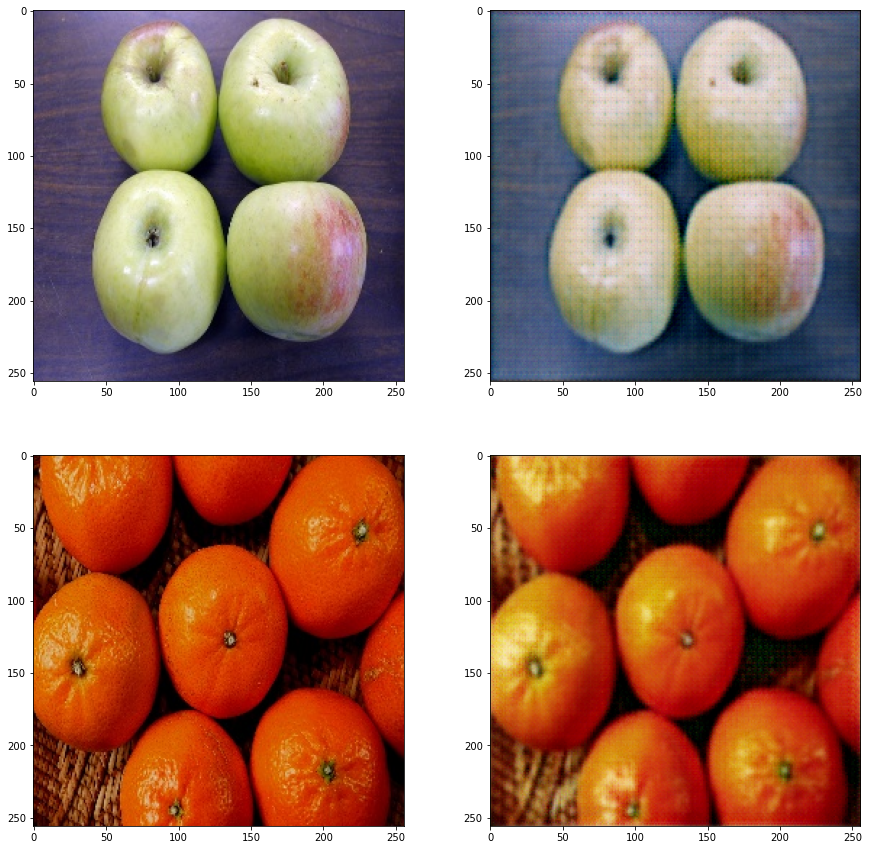

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  100


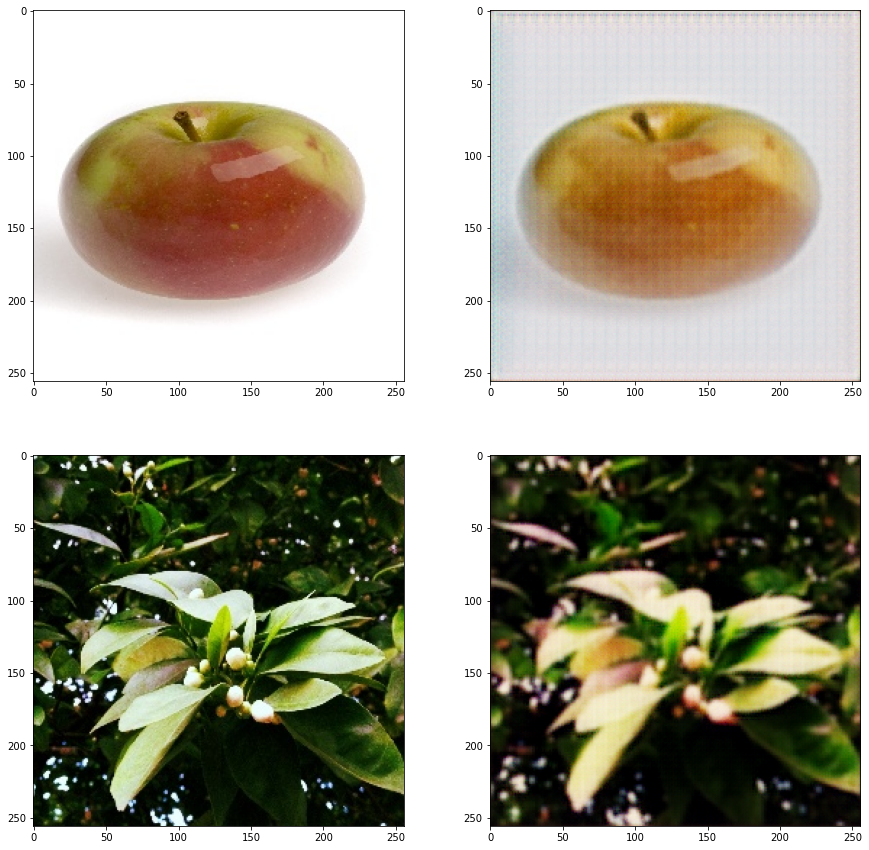

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  200


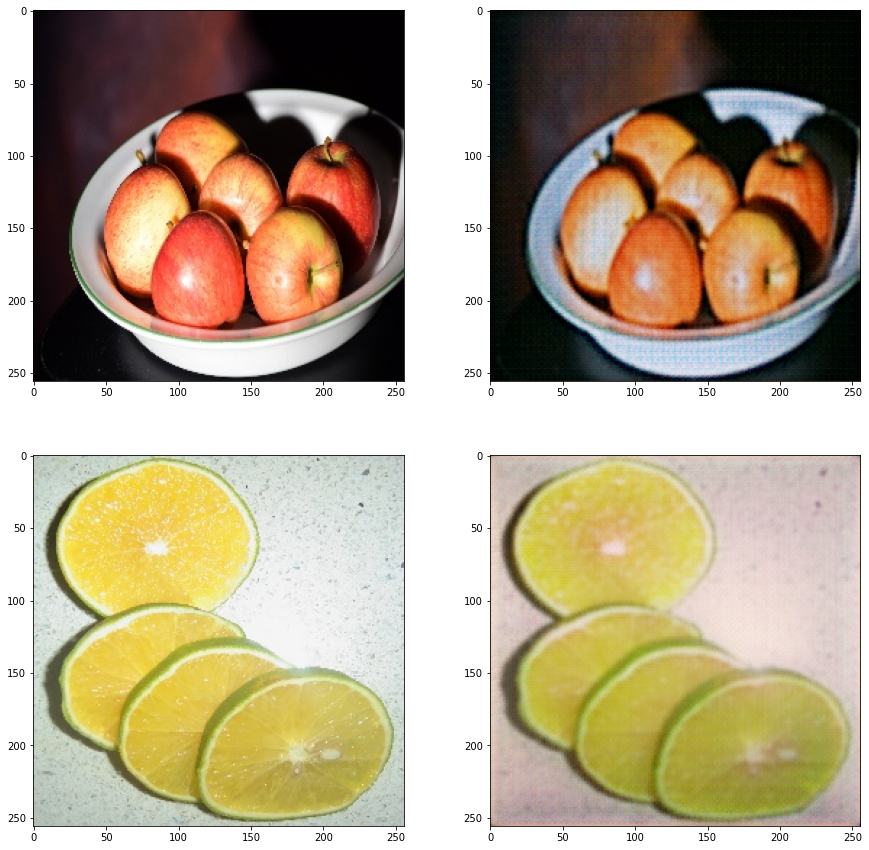

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  300


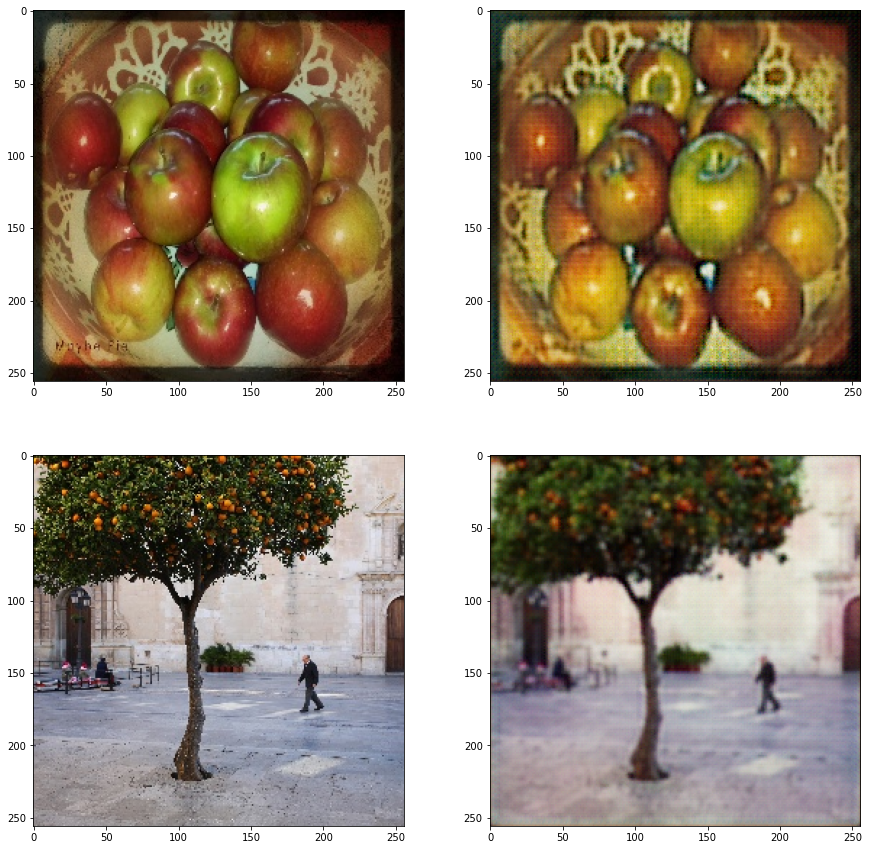

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  400


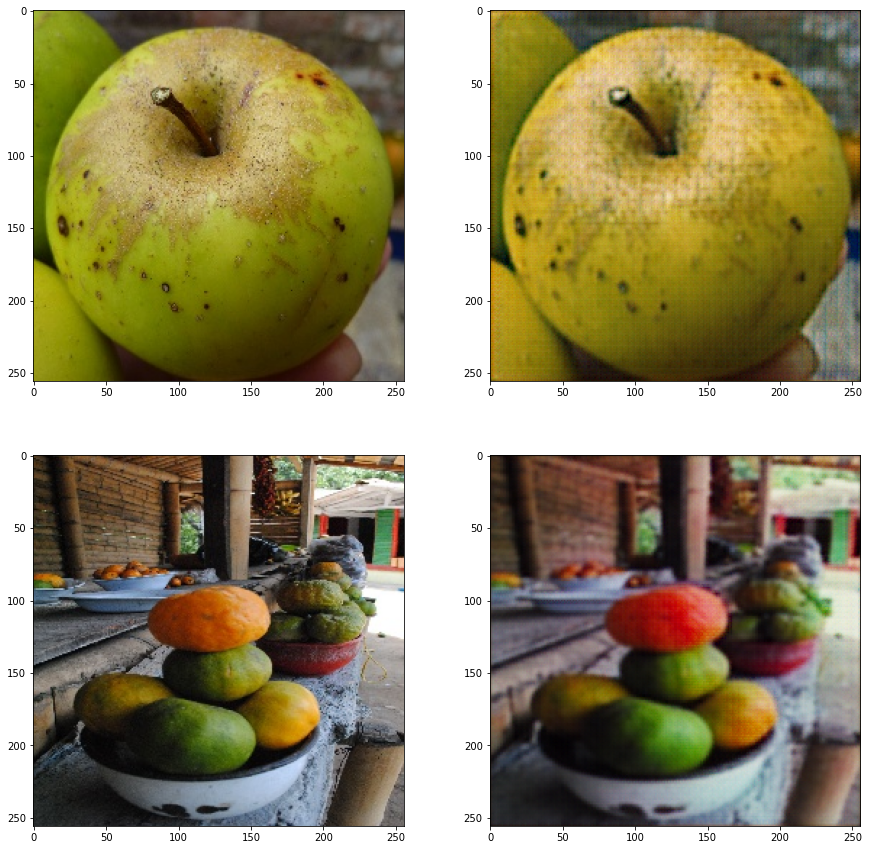

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  500


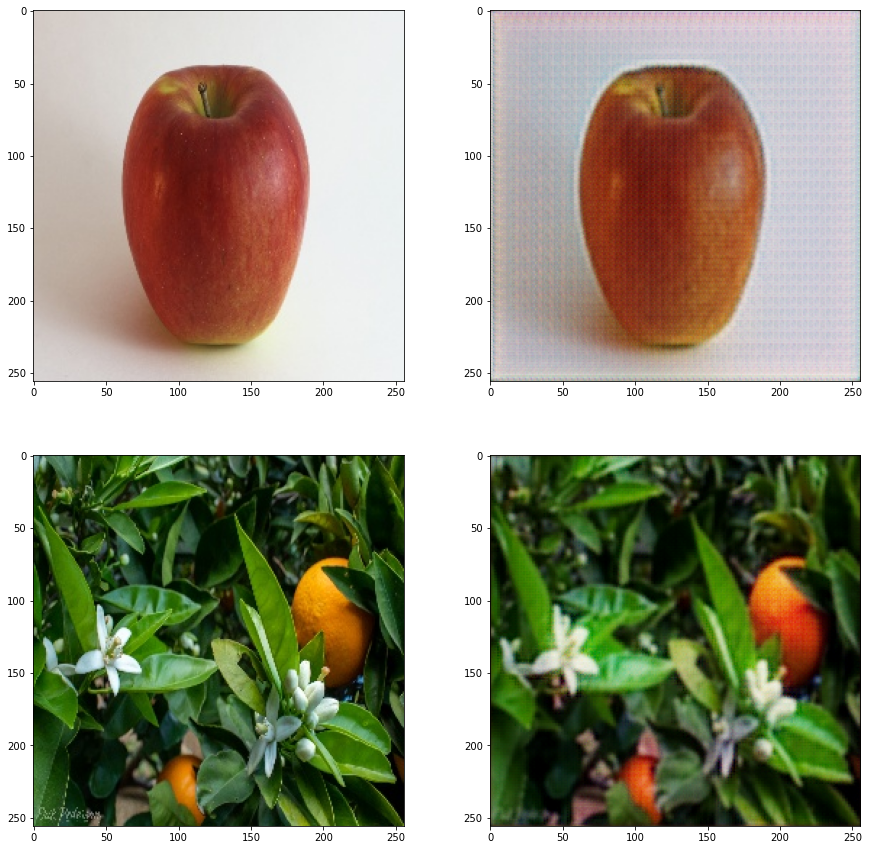

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  600


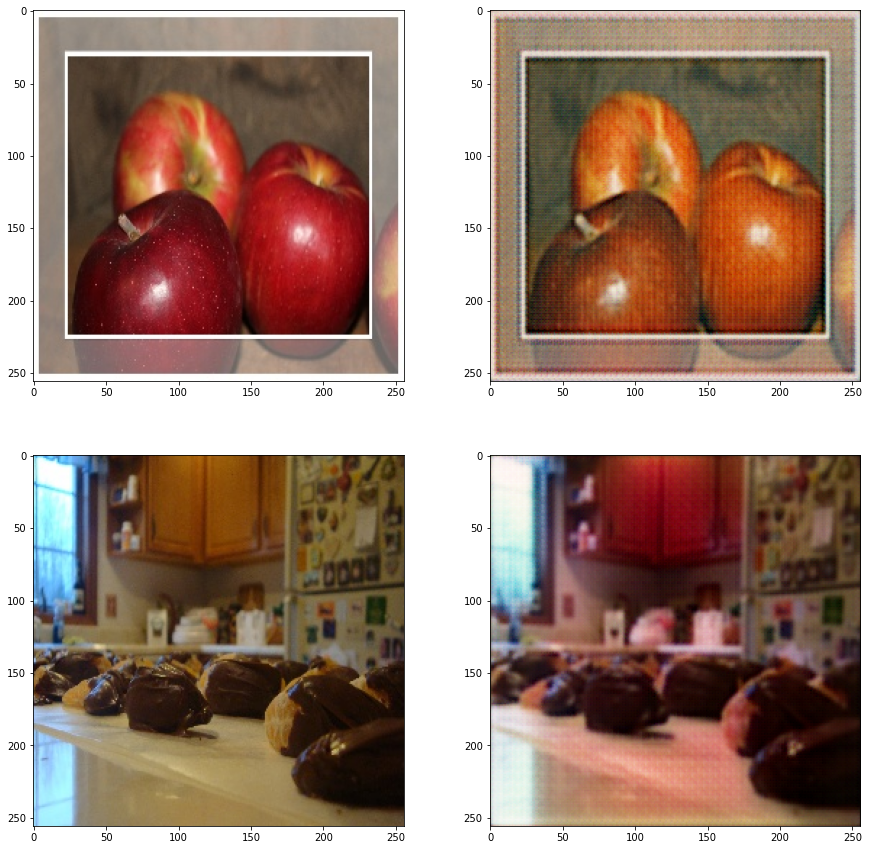

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  700


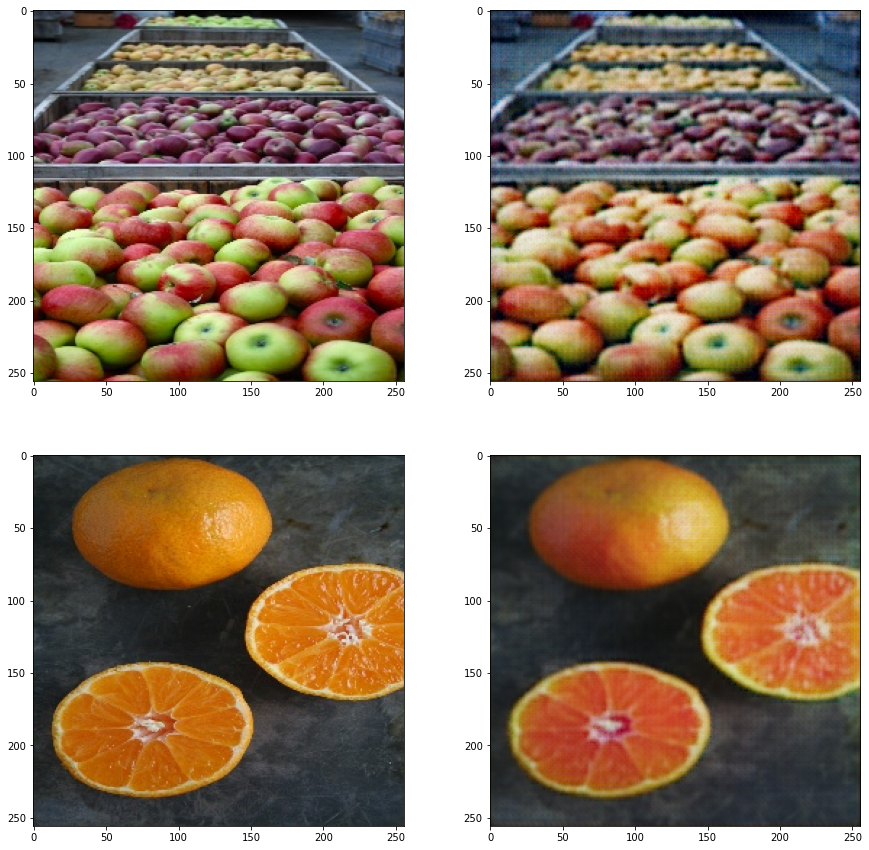

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  800


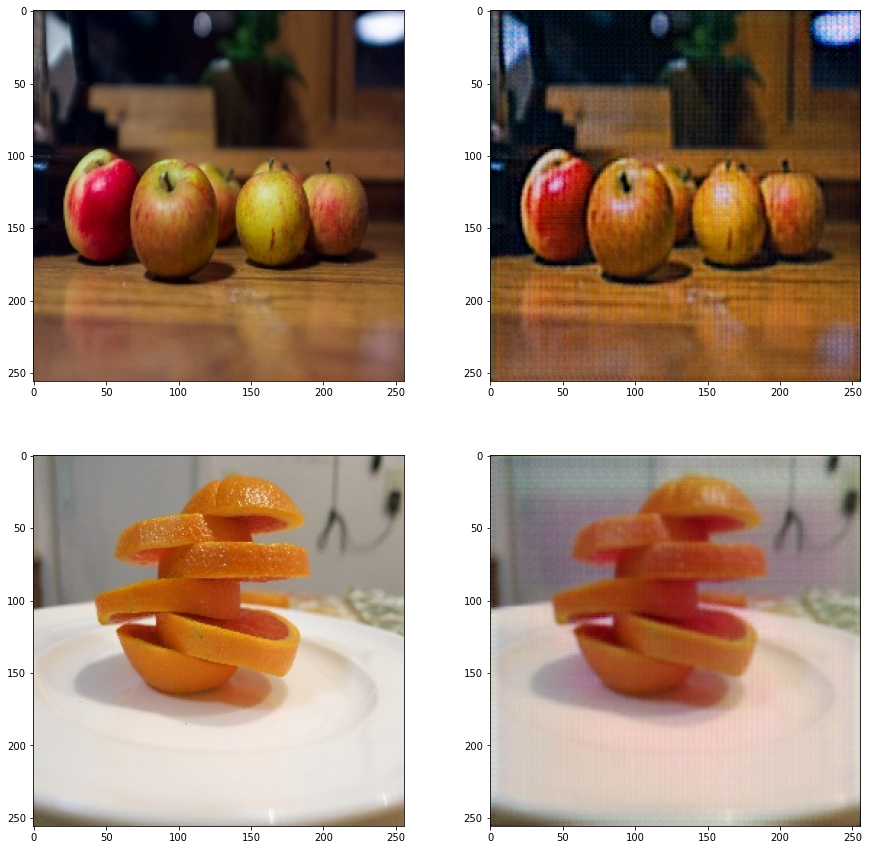

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  900


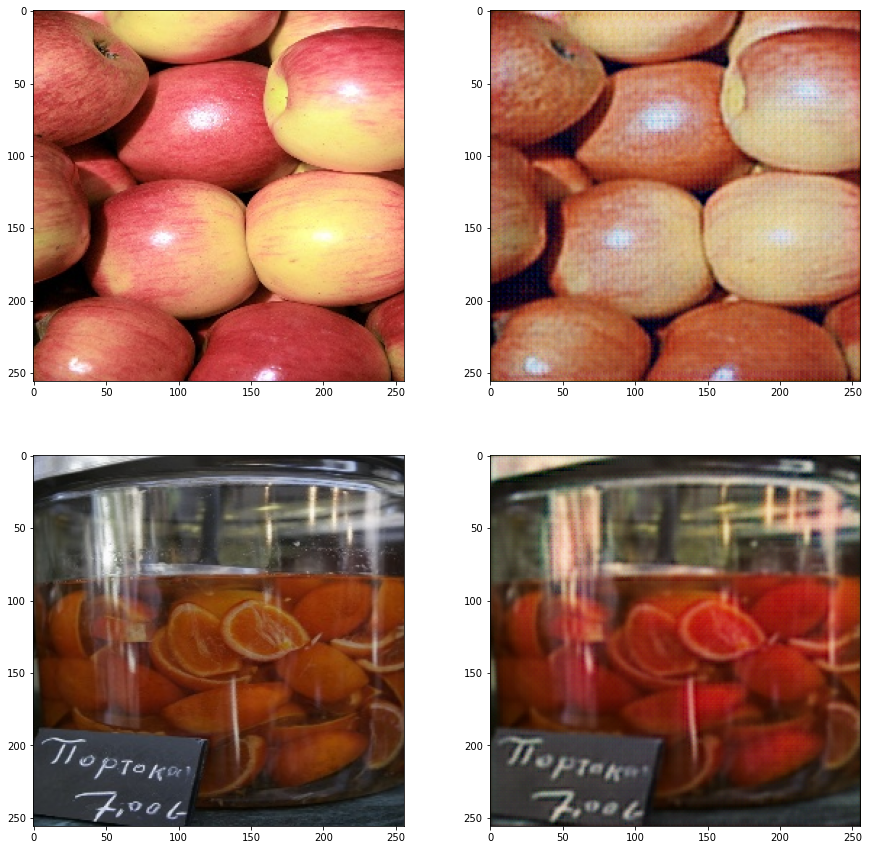

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  1000


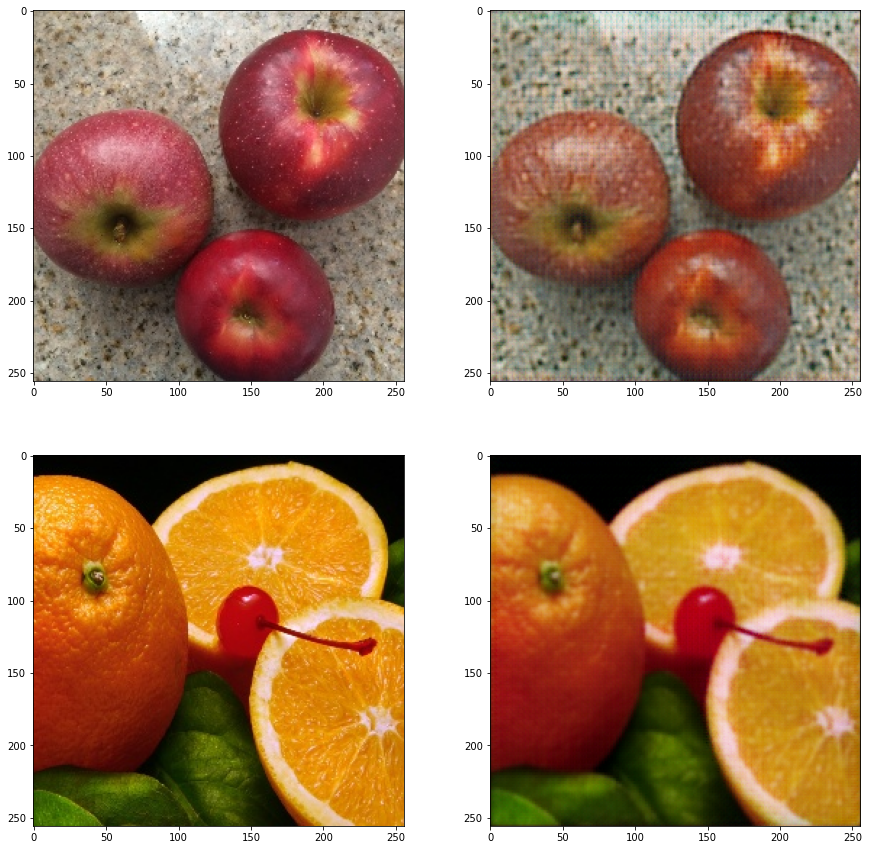

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  1100


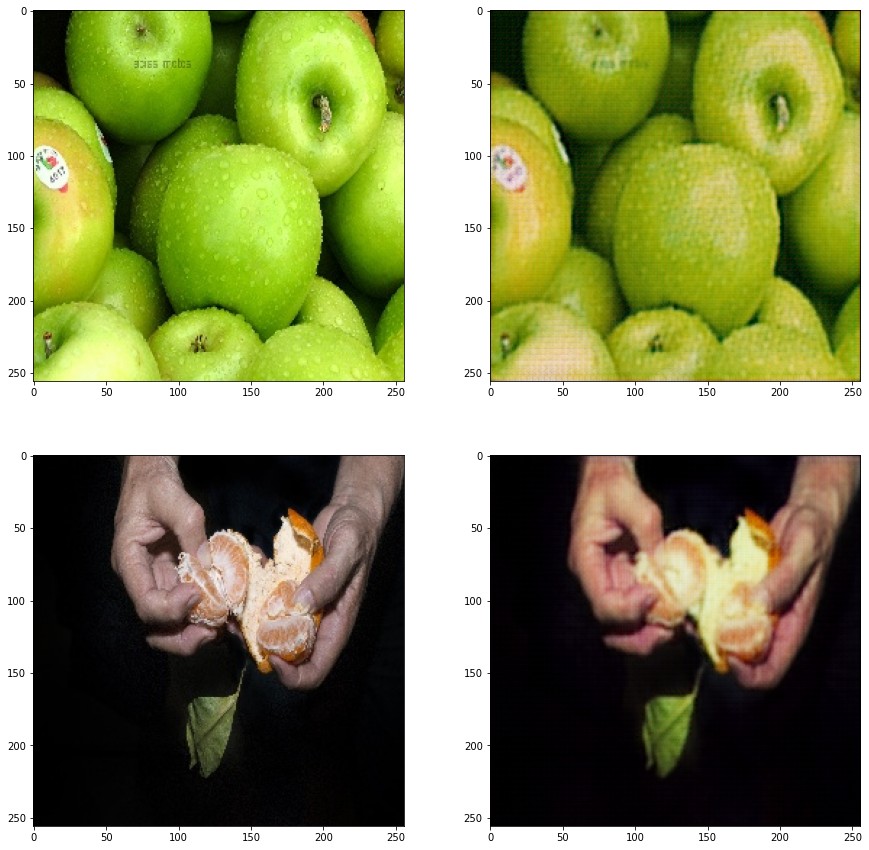

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  1200


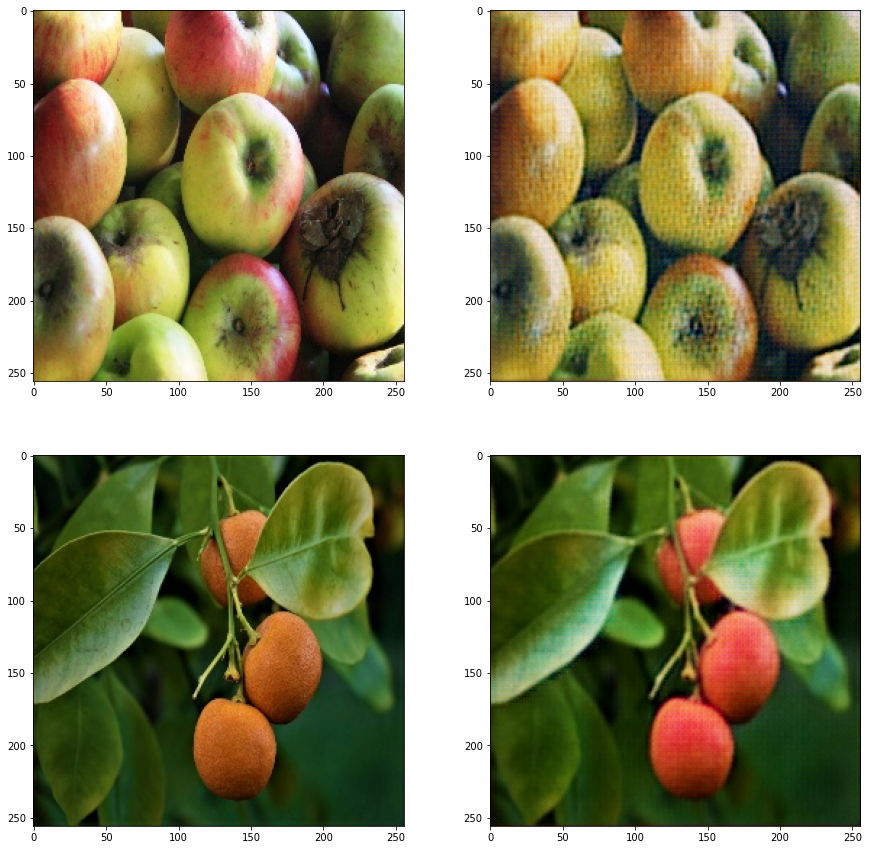

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  1300


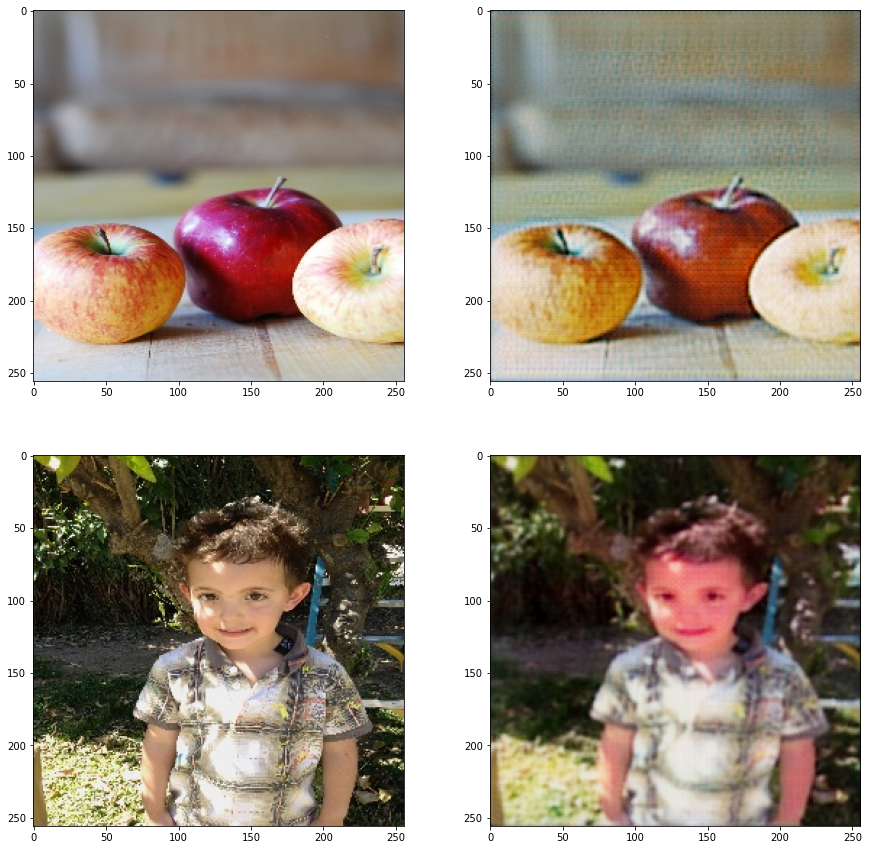

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  1400


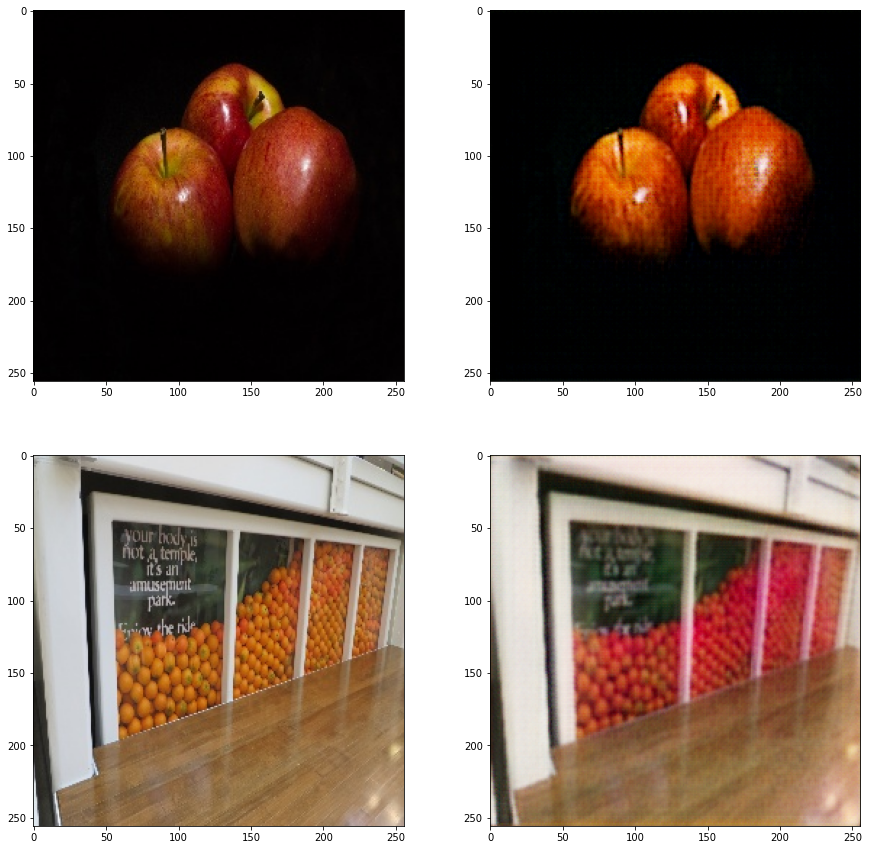

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  1500


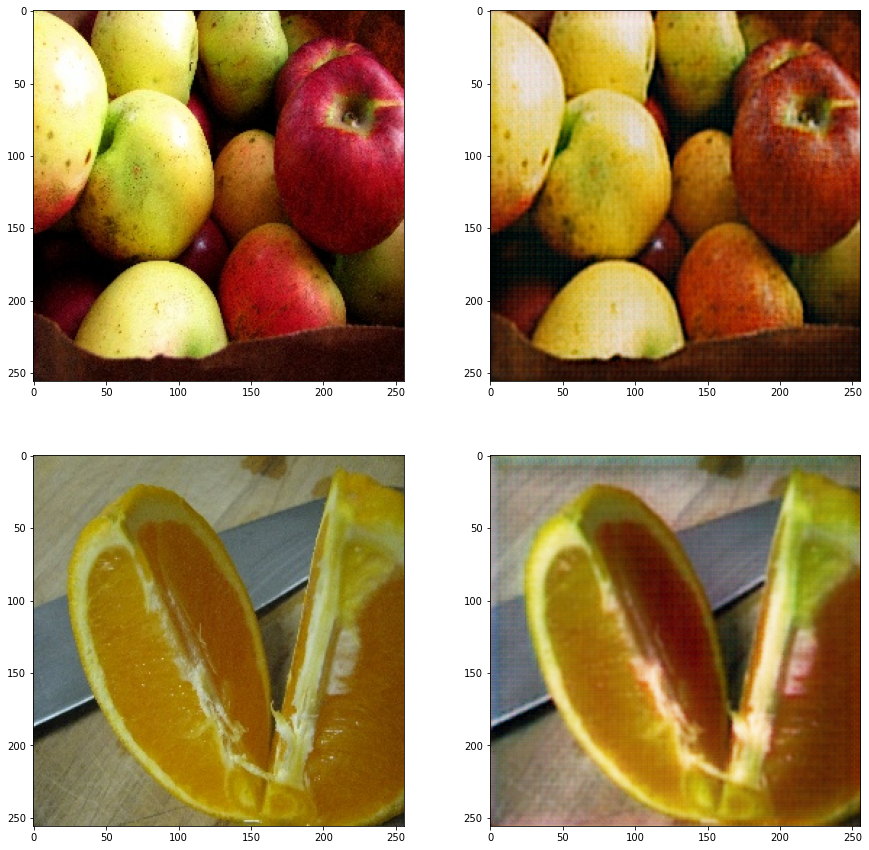

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  1600


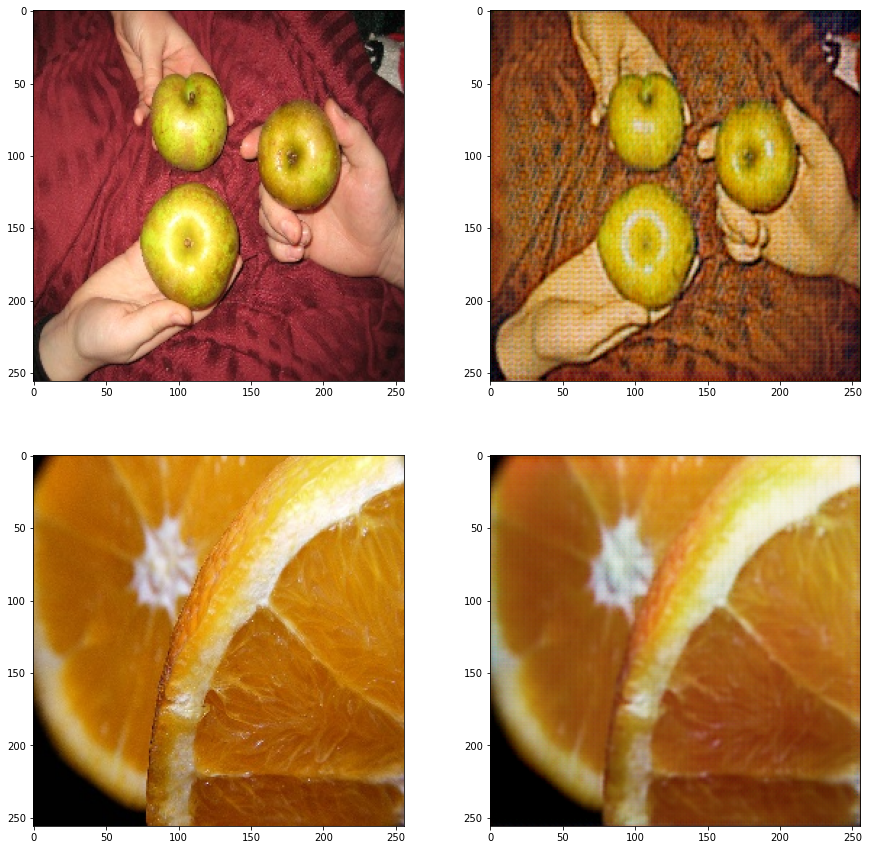

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  1700


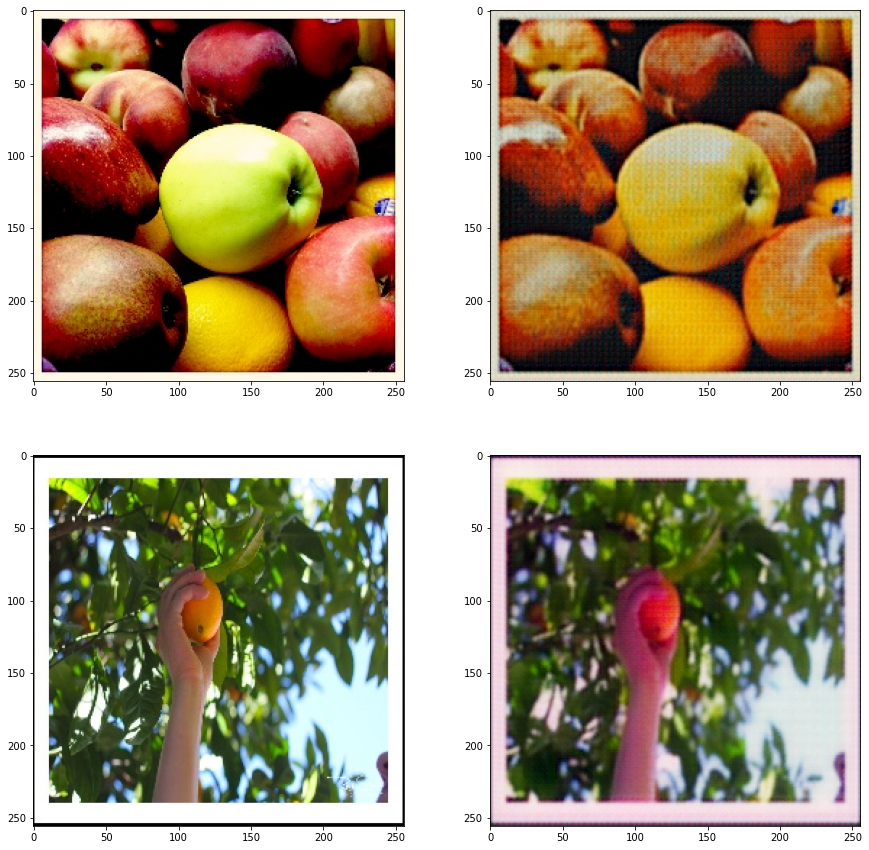

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  1800


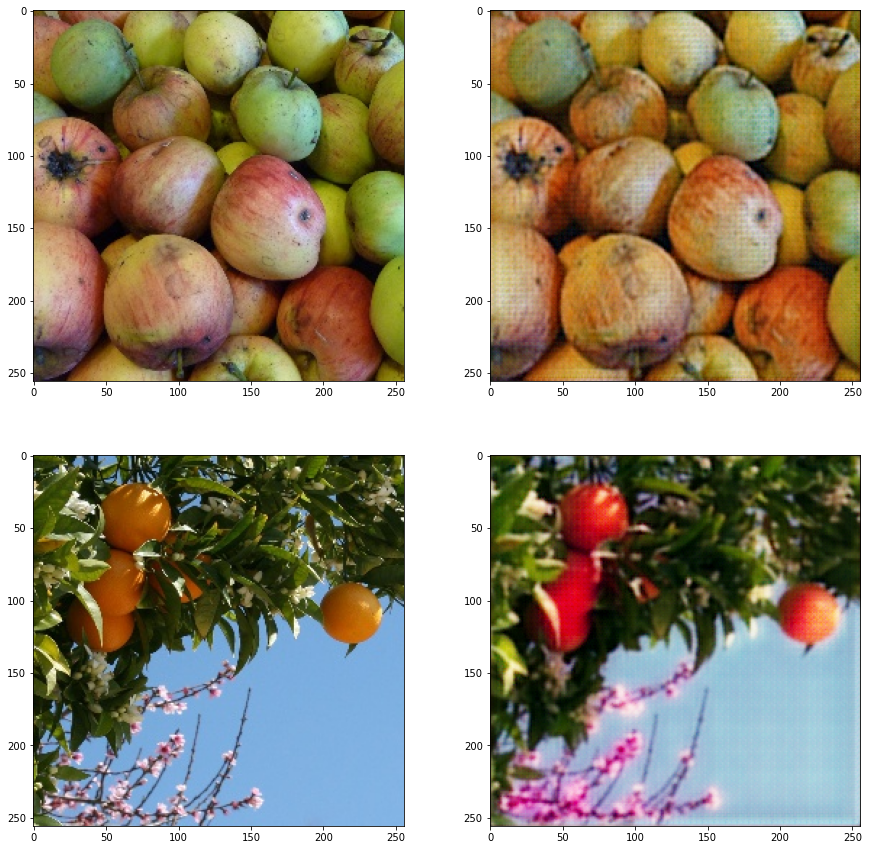

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  1900


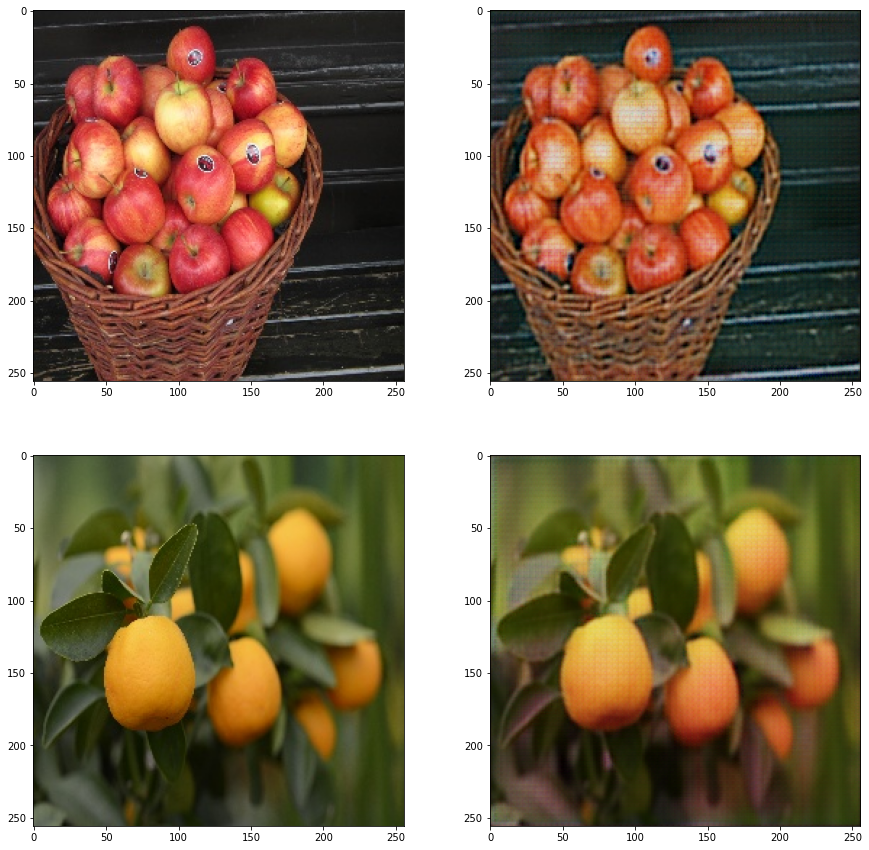

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  2000


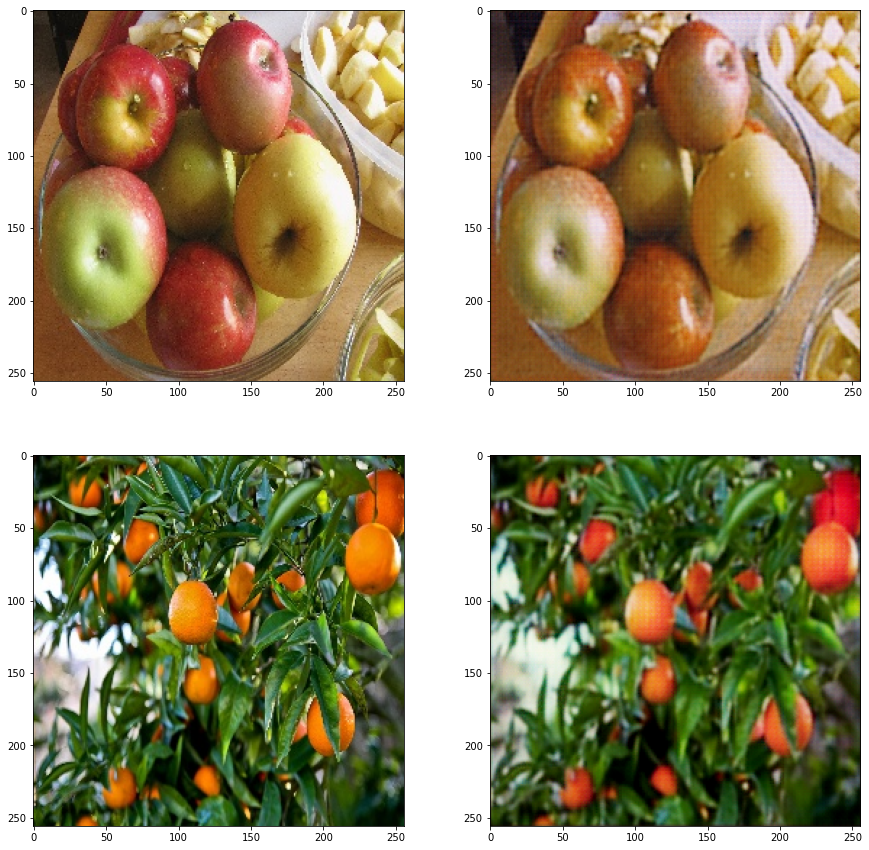

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  2100


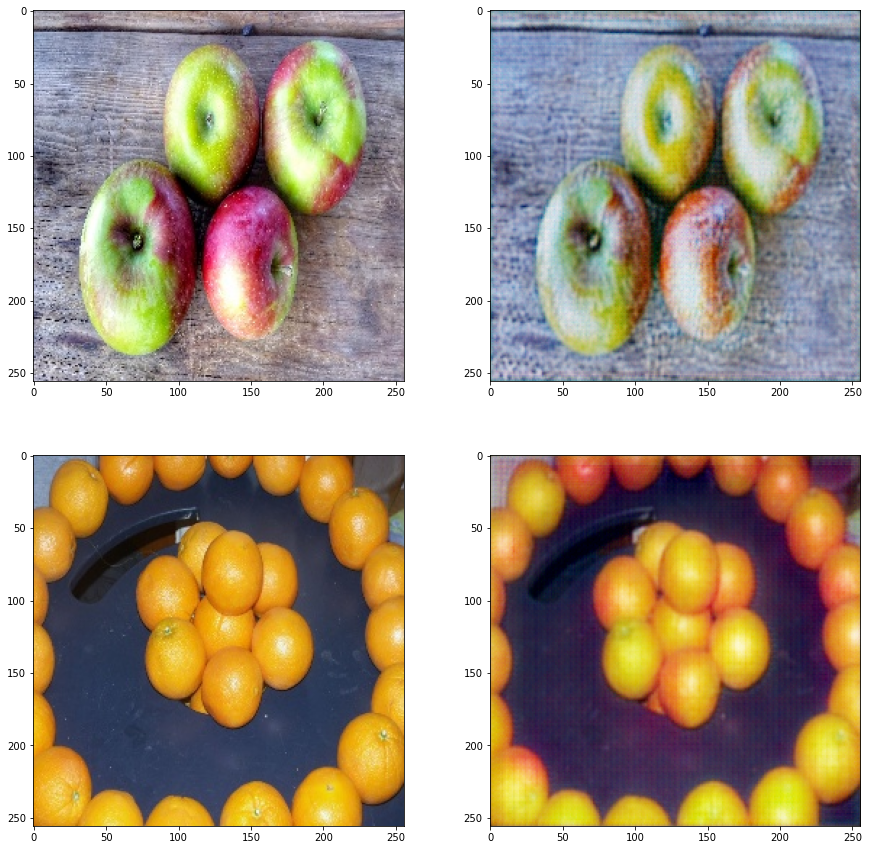

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  2200


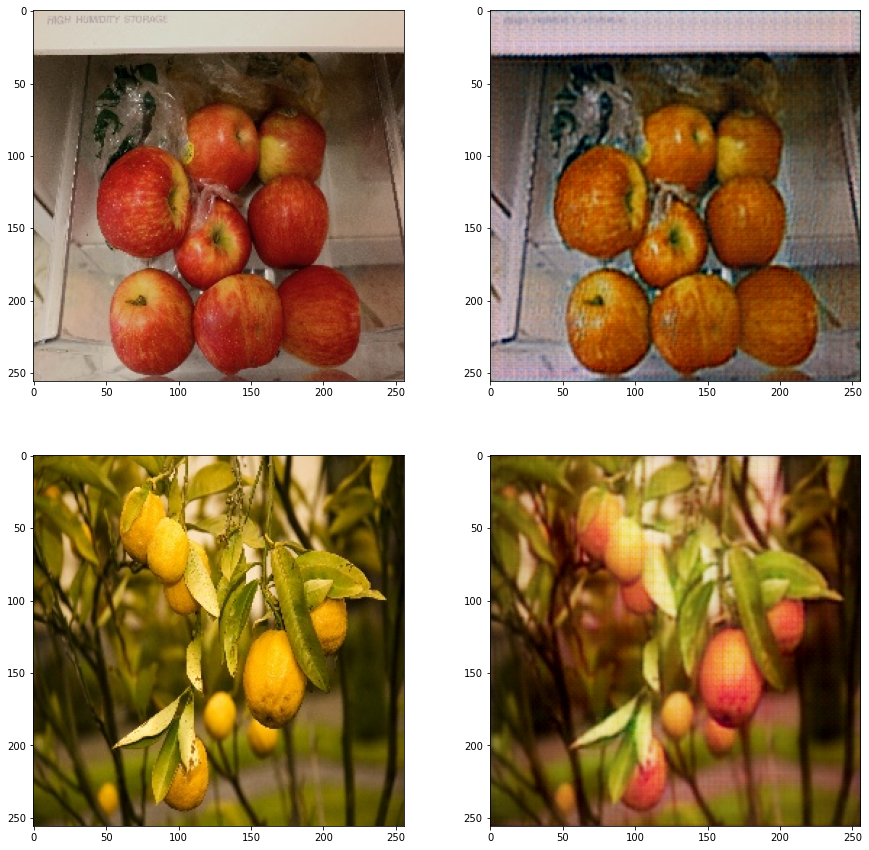

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  2300


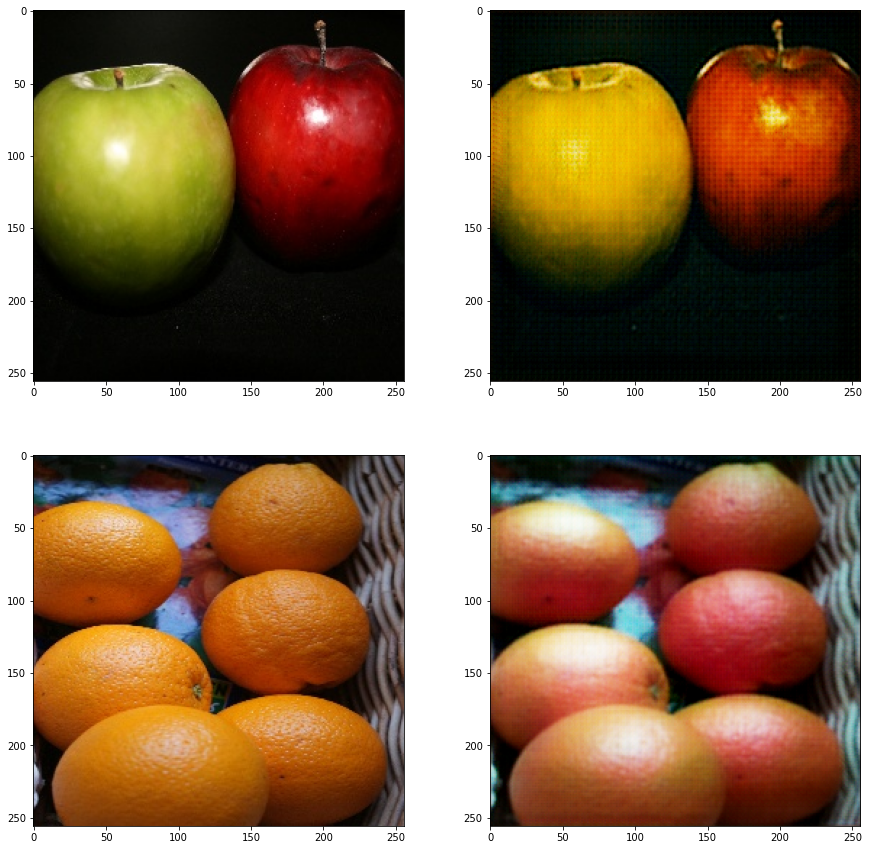

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  2400


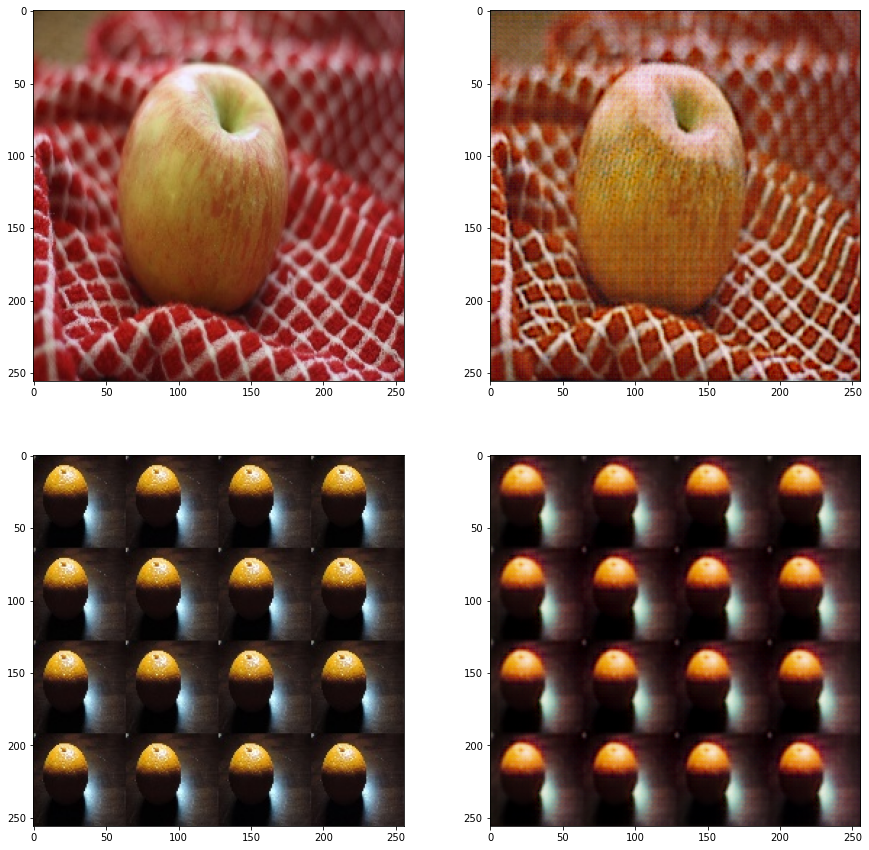

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  2500


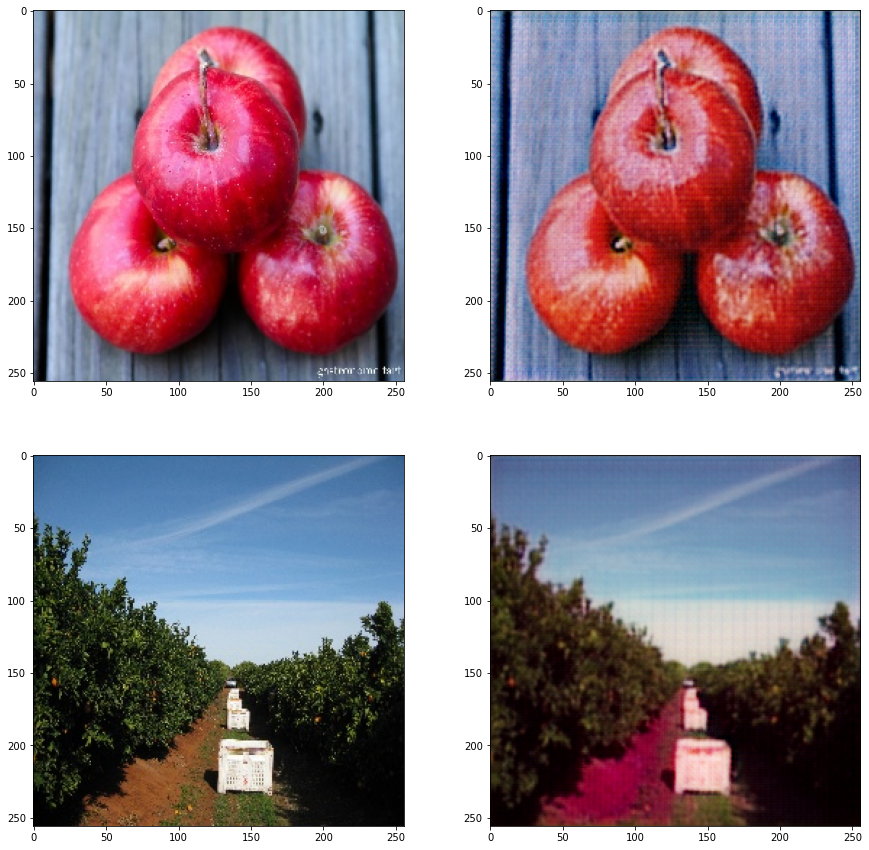

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  2600


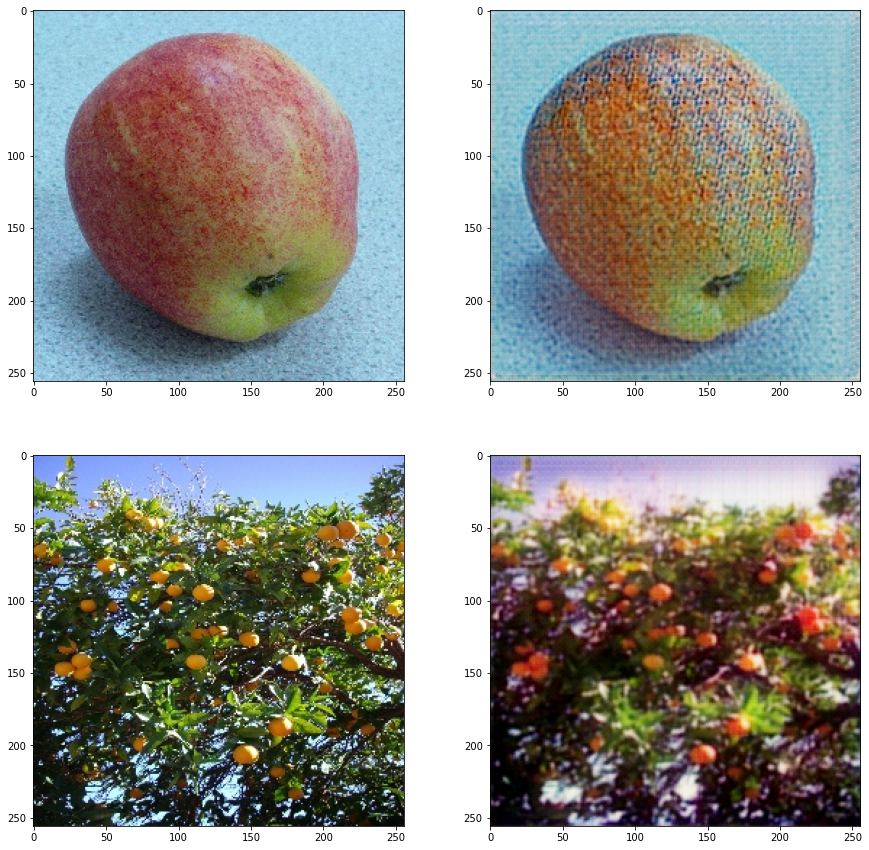

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  2700


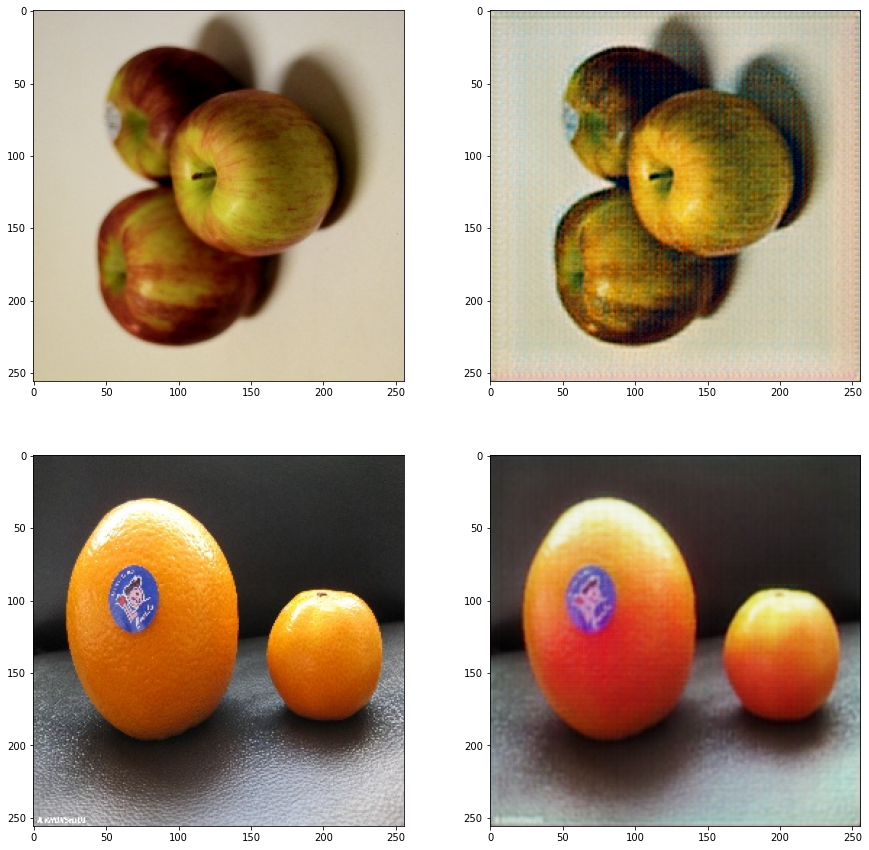

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  2800


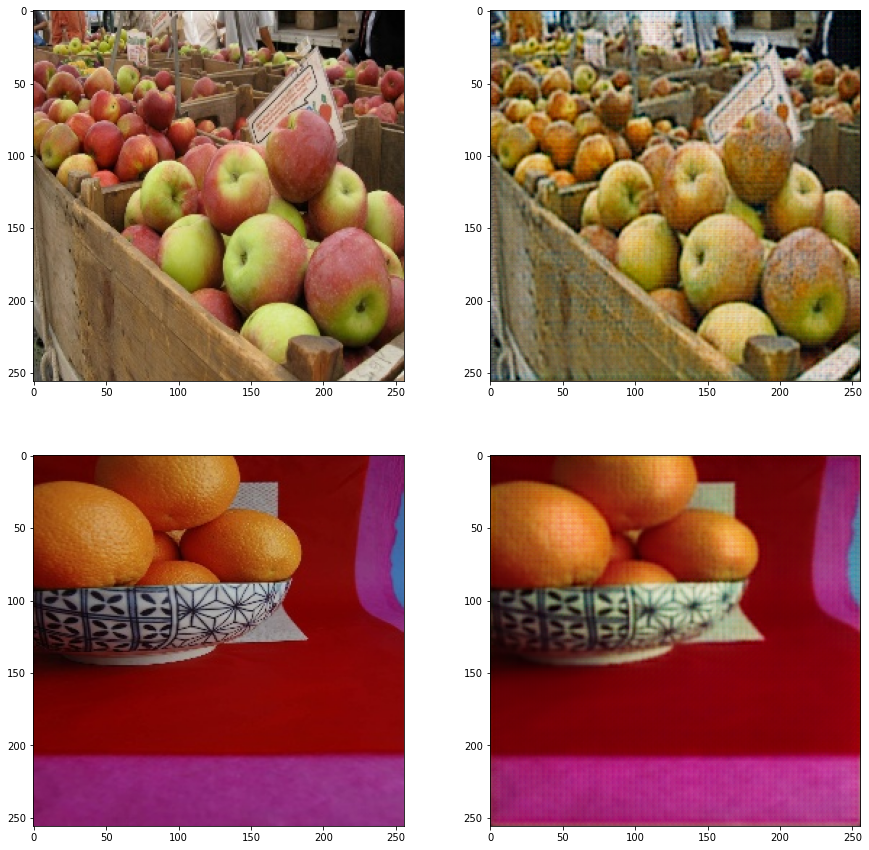

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  2900


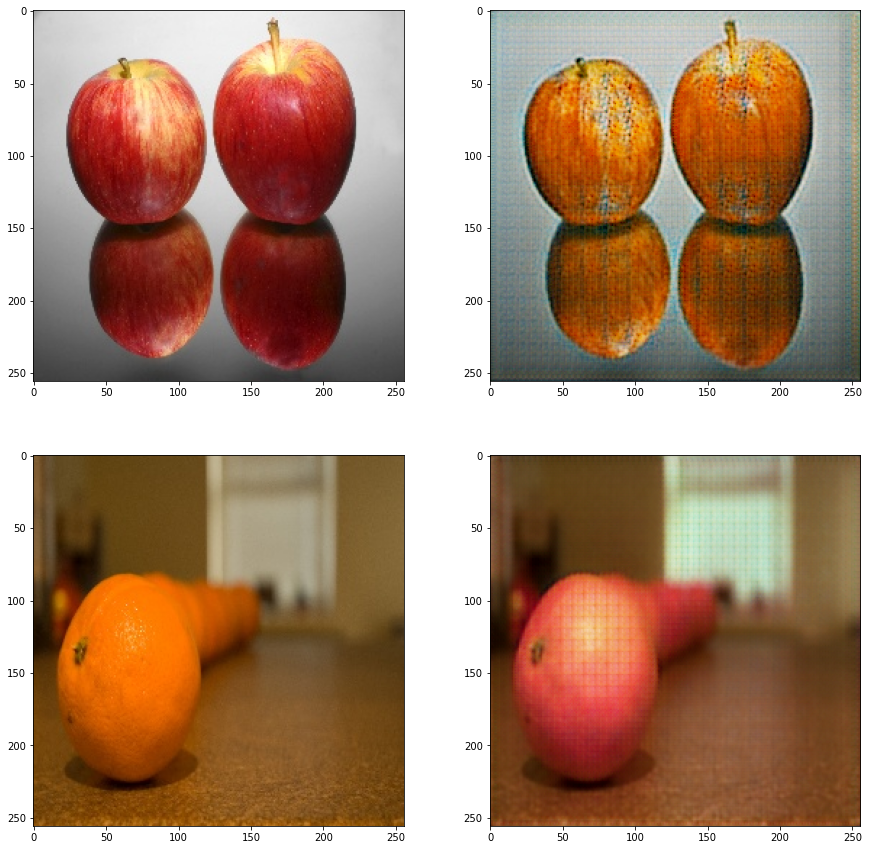

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  3000


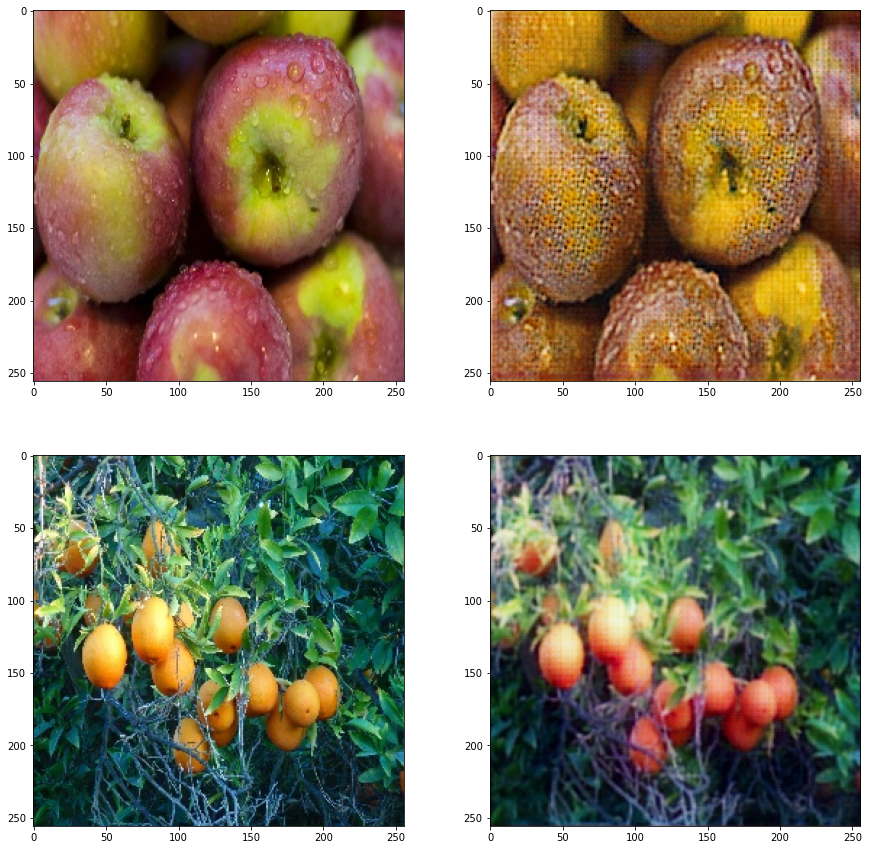

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  3100


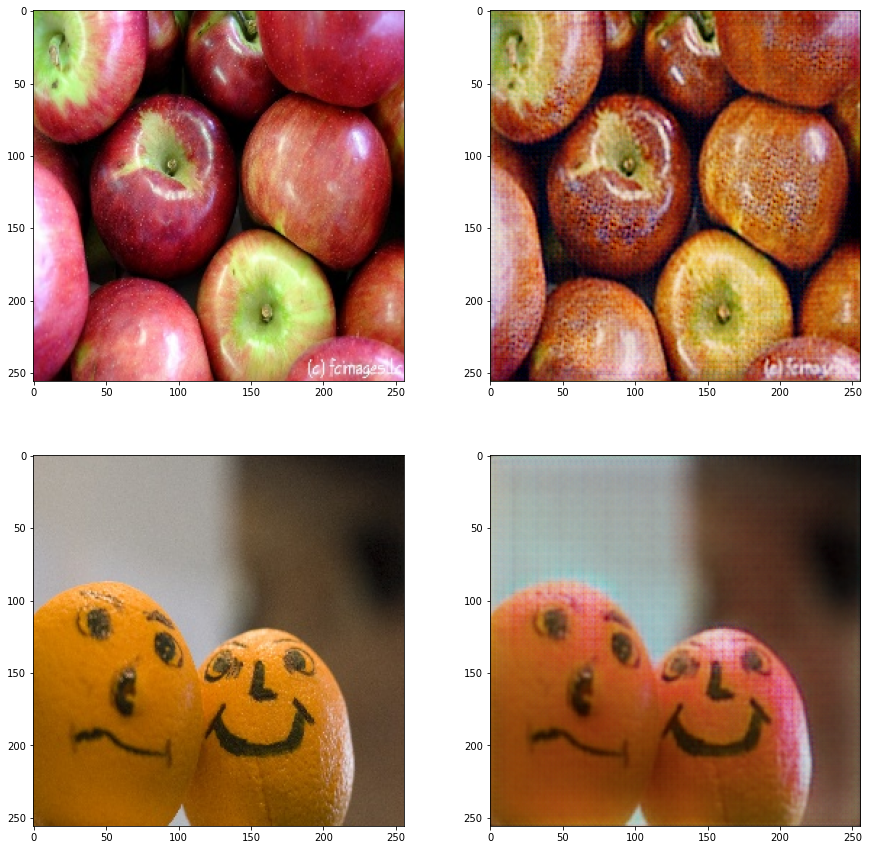

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  3200


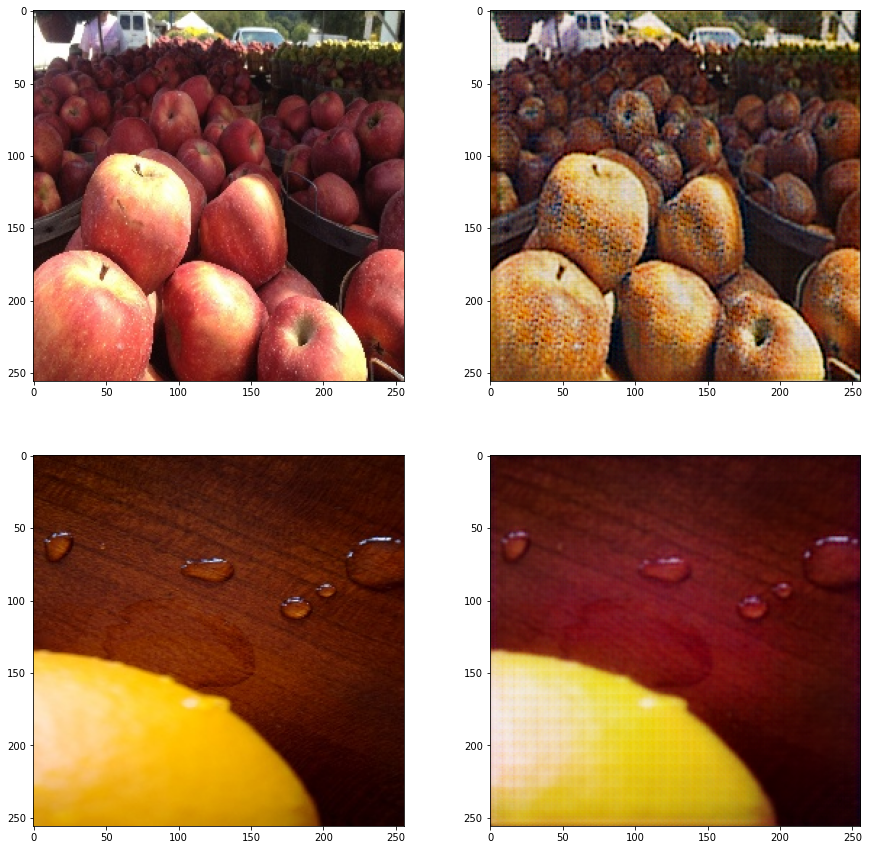

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  3300


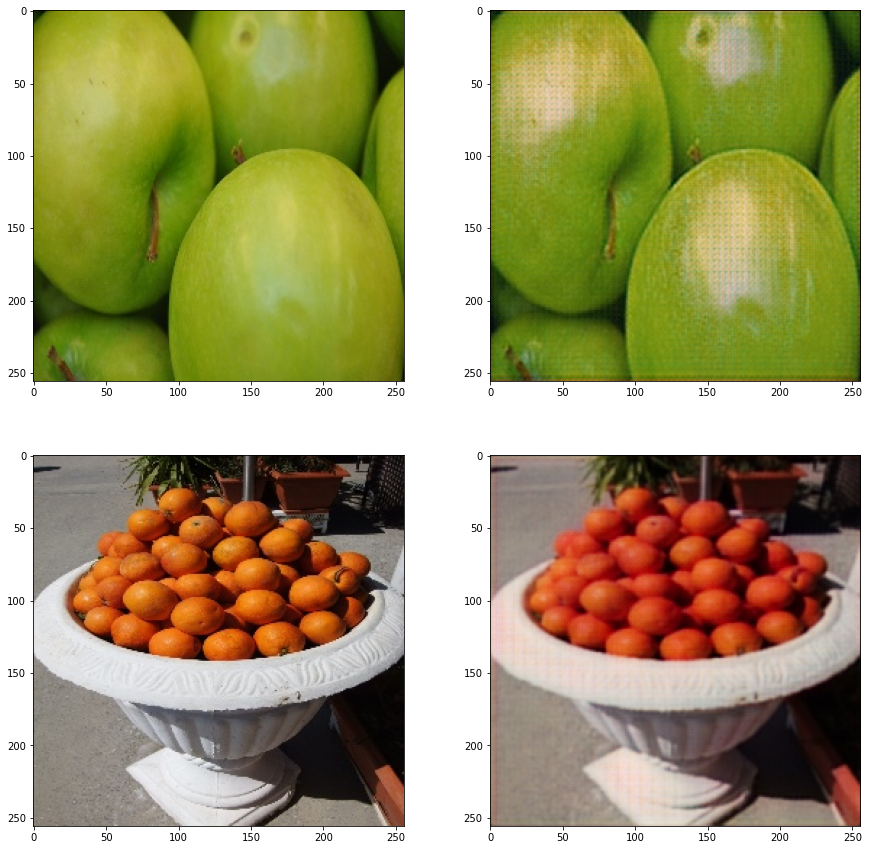

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  3400


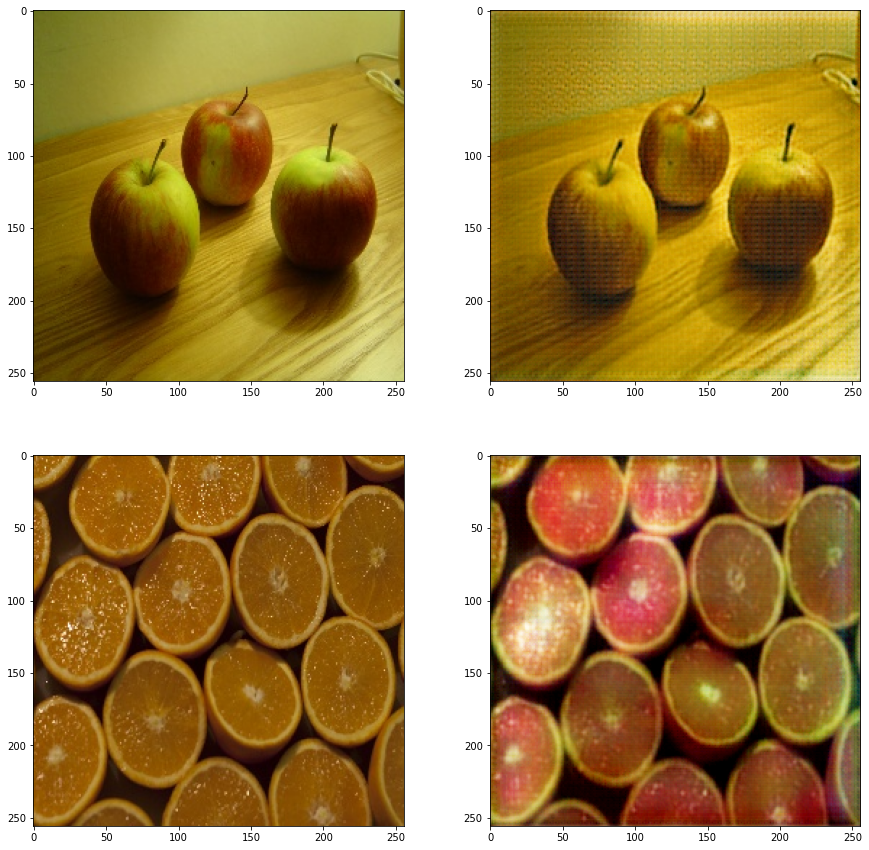

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  3500


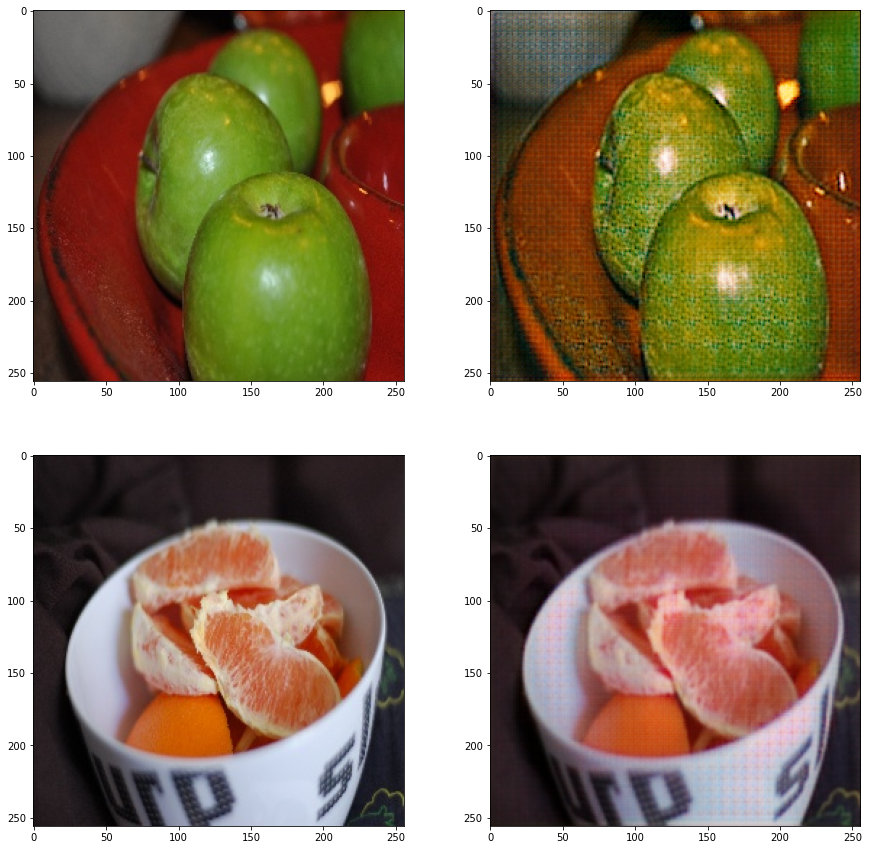

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  3600


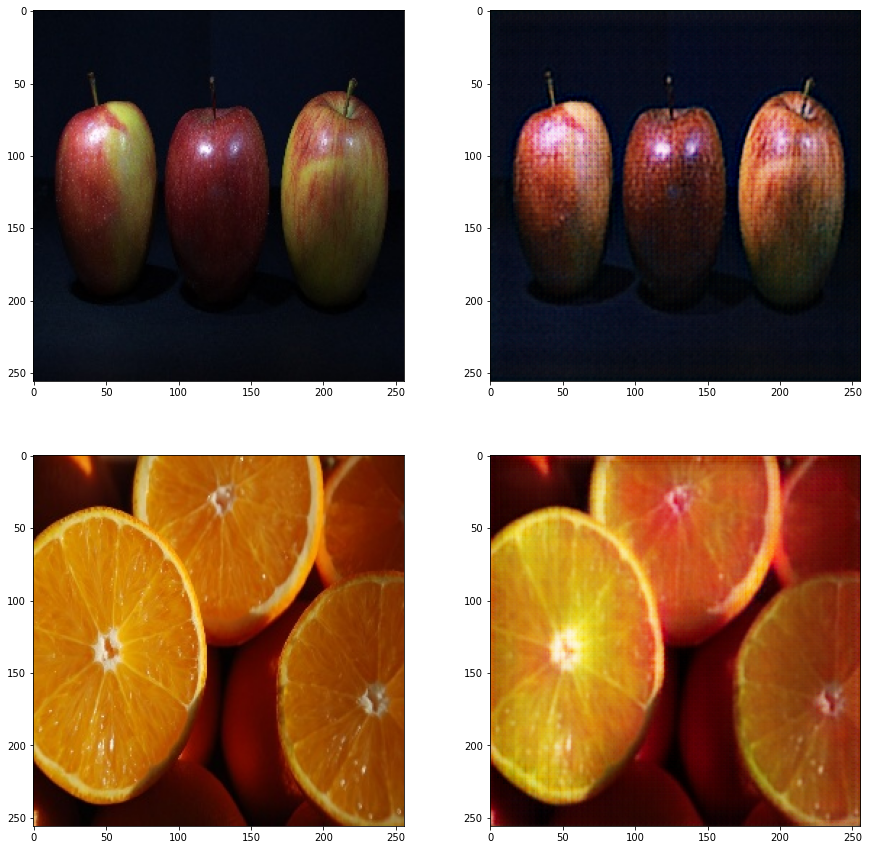

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  3700


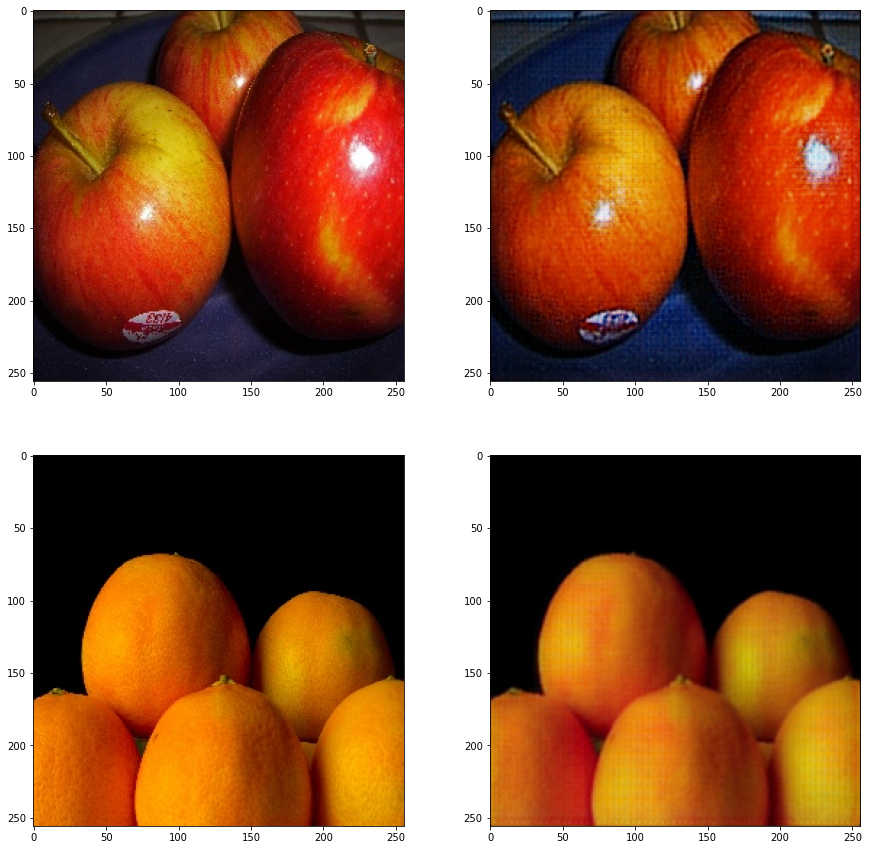

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  3800


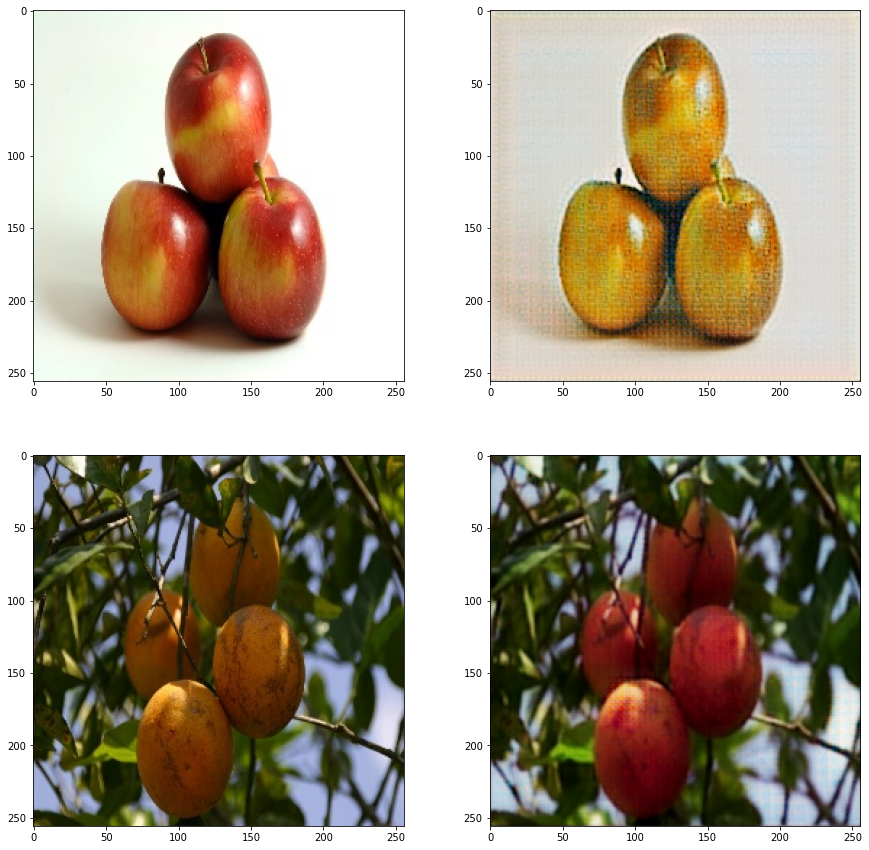

...................................................................................................

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


.
Epoch  3900
Buffered data was truncated after reaching the output size limit.

In [ ]:
EPOCHS = 5000
for e in range(EPOCHS):
    numberX = random.randrange(len(imagesX))
    numberY = random.randrange(len(imagesY))
    realX = imagesX[numberX]
    realY = imagesY[numberY]
    realX = np.expand_dims(realX,0)
    realY = np.expand_dims(realY,0)
    step(realX,realY,e)